In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap, ListedColormap
import pydot

import itertools
import networkx as nx

from scipy.stats import spearmanr
from causallearn.utils.cit import CIT

In [2]:
# total edges in complete graph
1128 * 1127 / 2

635628.0

# Remove features that are highly correlated with another

# Sure Screening for Edges in the Microbe-Microbe Interaction Network
1. Spearman
2. SparCC
3. Graphical LASSO (not sure screening, also assumes data are multivariate normal)

In [3]:
hc = pd.read_csv("../data/hc.csv", index_col=0)
pcos = pd.read_csv("../data/pcos.csv", index_col=0)

In [4]:
hc

,region,study_site,Acetatifactor,Acetivibrio,Acidaminococcus,Acinetobacter,Actinomyces,Acutalibacter,Adlercreutzia,Aeromicrobium,...,UCG-003,UCG-004,UCG-005,UCG-009,UCG-010,Varibaculum,Veillonella,Weissella,Xanthomonas,Unclassified
SRR4457864,0,1,0.0,0.0,0.0,0.000000,0.026594,0.0,0.033847,0.0,...,0.055605,0.0,0.834079,0.000000,0.000000,0.0,0.000000,0.0,0.0,3.640935
SRR4457873,0,1,0.0,0.0,0.0,0.000000,0.016925,0.0,0.000000,0.0,...,0.198259,0.0,0.041103,0.000000,0.009671,0.0,0.043520,0.0,0.0,7.630561
SRR4457876,0,1,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.192395,0.0,0.033523,0.000000,0.000000,0.0,0.119518,0.0,0.0,7.448002
SRR4457877,0,1,0.0,0.0,0.0,0.000000,0.019861,0.0,0.000000,0.0,...,0.465969,0.0,0.200137,0.000000,0.000000,0.0,0.000000,0.0,0.0,6.459400
SRR4457878,0,1,0.0,0.0,0.0,0.000000,0.037431,0.0,0.034935,0.0,...,0.416729,0.0,1.766732,0.064880,0.137246,0.0,0.000000,0.0,0.0,7.031991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR24874411,1,14,0.0,0.0,0.0,0.000000,0.449171,0.0,0.000000,0.0,...,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.183858,0.0,0.0,3.460715
SRR24874412,1,14,0.0,0.0,0.0,0.000000,0.219071,0.0,0.000000,0.0,...,0.088237,0.0,0.660257,0.000000,0.015213,0.0,0.000000,0.0,0.0,2.002069
SRR24874413,1,14,0.0,0.0,0.0,0.000000,0.080953,0.0,0.040477,0.0,...,0.000000,0.0,0.880366,0.015179,0.877837,0.0,0.070834,0.0,0.0,2.570265
SRR24874414,1,14,0.0,0.0,0.0,0.025611,1.265607,0.0,0.044819,0.0,...,0.055490,0.0,0.565575,0.012805,0.000000,0.0,0.021342,0.0,0.0,1.438480


In [5]:
pcos

,region,study_site,Acetatifactor,Acetivibrio,Acidaminococcus,Acinetobacter,Actinomyces,Acutalibacter,Adlercreutzia,Aeromicrobium,...,UCG-003,UCG-004,UCG-005,UCG-009,UCG-010,Varibaculum,Veillonella,Weissella,Xanthomonas,Unclassified
SRR4457865,0,1,0.0,0.0,0.000000,0.0,0.013828,0.0,0.000000,0.0,...,0.140258,0.027657,0.057288,0.000000,0.000000,0.0,0.003951,0.0,0.0,3.913396
SRR4457866,0,1,0.0,0.0,0.000000,0.0,0.016467,0.0,0.038423,0.0,...,0.000000,0.000000,0.003659,0.005489,0.093313,0.0,0.040252,0.0,0.0,1.562529
SRR4457867,0,1,0.0,0.0,0.000000,0.0,0.021512,0.0,0.000000,0.0,...,0.131028,0.000000,0.056714,0.000000,0.000000,0.0,0.097782,0.0,0.0,3.621856
SRR4457868,0,1,0.0,0.0,0.000000,0.0,0.000000,0.0,0.051588,0.0,...,0.000000,0.000000,0.254381,0.078271,0.058703,0.0,0.021347,0.0,0.0,4.907943
SRR4457869,0,1,0.0,0.0,0.000000,0.0,0.027549,0.0,0.011479,0.0,...,0.000000,0.000000,0.247945,0.000000,0.000000,0.0,0.034437,0.0,0.0,5.737178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR24874401,1,14,0.0,0.0,0.000000,0.0,0.262331,0.0,0.000000,0.0,...,0.274705,0.000000,0.009899,0.000000,0.000000,0.0,0.064345,0.0,0.0,25.423813
SRR24874402,1,14,0.0,0.0,0.000000,0.0,0.035169,0.0,0.000000,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.189523,0.0,0.0,3.704500
SRR24874404,1,14,0.0,0.0,0.000000,0.0,0.474964,0.0,0.155638,0.0,...,0.000000,0.000000,0.037568,0.000000,0.000000,0.0,0.110020,0.0,0.0,1.894488
SRR24874405,1,14,0.0,0.0,0.003387,0.0,0.279429,0.0,0.000000,0.0,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.450473,0.0,0.0,0.111772


## 1. Spearman on PCOS

In [172]:
hc_adj = np.full((hc.shape[1], hc.shape[1]), 0)
pcos_adj = np.full((pcos.shape[1], pcos.shape[1]), 0)

bonf = hc.shape[1] * hc.shape[1] // 2 # correct by number of unique tests

for i in range(hc.shape[1]):
    print(hc.columns[i])
    for j in range(i, hc.shape[1]):
        hc_corr = spearmanr(hc.iloc[:, i], hc.iloc[:, j])
        pcos_corr = spearmanr(pcos.iloc[:, i], pcos.iloc[:, j])
        if hc_corr[1] < 0.05 / bonf:
            hc_adj[i, j] = 1
        if pcos_corr[1] < 0.05 / bonf:
            pcos_adj[i, j] = 1

hc_adj = hc_adj - np.eye(hc.shape[1])
pcos_adj = pcos_adj - np.eye(pcos.shape[1])

region


/var/folders/hc/mnggsfz56v305wwb48gk6cjm0000gp/T/ipykernel_63446/304520813.py:9: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  hc_corr = spearmanr(hc.iloc[:, i], hc.iloc[:, j])
/var/folders/hc/mnggsfz56v305wwb48gk6cjm0000gp/T/ipykernel_63446/304520813.py:10: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  pcos_corr = spearmanr(pcos.iloc[:, i], pcos.iloc[:, j])


01D2Z36
0319-6G20
0319-7L14
27F-1492R
37-13
67-14
A2
Abiotrophia
Absconditabacteriales_(SR1)
Abyssivirga
Acetanaerobacterium
Acetatifactor
Acetitomaculum
Acetivibrio
Acetoanaerobium
Acetobacter
Acetobacterium
Acholeplasma
Acidaminobacter
Acidaminococcus
Acidibacter
Acidipila
Acidothermus
Acidovorax
Acinetobacter
Actinobacillus
Actinomyces
Actinophytocola
Actinospica
Acutalibacter
AD3
Adhaeribacter
Adlercreutzia
Aerococcus
Aeromicrobium
Aeromonas
Agathobacter
Agathobaculum
Aggregatibacter
Agrilactobacillus
Agrobacterium
Agromyces
AKIW781
Akkermansia
AKYG1722
AKYH767
Alcanivorax
Alicyclobacillus
Aliihoeflea
Aliikangiella
Alishewanella
Alistipes
Alkalibacterium
Alkalibaculum
Alkalicoccus
Alkalihalobacillus
Alkaliphilus
Allisonella
Allobaculum
Alloprevotella
Allorhizobium-Neorhizobium-Pararhizobium-Rhizobium
Alloscardovia
Altererythrobacter
Alteribacillus
Alterileibacterium
Amedibacillus
Amedibacterium
Aminicella
Aminicenantales
Aminipila
Ammoniibacillus
Ammoniphilus
Amphibacillus
Amphorel

In [181]:
hc_adj.sum()

np.float64(174515.0)

In [180]:
pcos_adj.sum()

np.float64(180601.0)

## 2. SparCC on PCOS

How to use SparCC:
1. Update the `configuration.yml` file
2. Run `python General_Execution.py`

In [8]:
def get_sig_cor_pairs(sparcc_fp, sparcc_pval_fp, cohort_fp):
    '''
    Returns a dataframe of the pairs of genera that had a significant correlation (p <= 0.05). 

    :param: sparcc_fp: filepath to the sparcc correlations
    :param: sparcc_pval_fp: filepath to the p-values of the sparcc correlations
    :param: cohort: filepath to the dataframe corresponding to the cohort

    :return: pandas DataFrame of the significant correlations
    '''
    sparcc = pd.read_csv(sparcc_fp)
    sparcc = sparcc.iloc[:, 1:]
    cohort = pd.read_csv(cohort_fp)
    cohort = cohort.iloc[:, 1:]
    sparcc.columns = cohort.columns

    sparcc_pval = pd.read_csv(sparcc_pval_fp)
    sparcc_pval = sparcc_pval.iloc[:, 1:]
    sparcc_pval.columns = cohort.columns

    sparcc_genus_A, sparcc_genus_B, sparcc_rho, sparcc_p = [], [], [], []
    
    for i in range(sparcc_pval.shape[1]):
        for j in range(i, sparcc_pval.shape[1]):
            if sparcc_pval.iloc[i, j] <= 0.05:
                sparcc_genus_A.append(sparcc_pval.columns[i])
                sparcc_genus_B.append(sparcc_pval.columns[j])
                sparcc_rho.append(sparcc.iloc[i, j])
                sparcc_p.append(sparcc_pval.iloc[i, j])

    sparcc_sig = pd.DataFrame(data = {'genus_A': sparcc_genus_A,
                                      'genus_B': sparcc_genus_B,
                                      'rho': sparcc_rho,
                                      'p': sparcc_p})
    return sparcc_sig

In [41]:
get_sig_cor_pairs("../src/hc_sparcc.csv", "../src/hc_pvals_one_sided.csv", "../data/hc.csv").to_csv("sparcc_hc_screened.csv")

In [45]:
get_sig_cor_pairs("../src/pcos_sparcc.csv", "../src/pcos_pvals_one_sided.csv", "../data/pcos.csv").to_csv("sparcc_pcos_screened.csv")

## 3. Graphical LASSO

In [65]:
# read in GLASSO sparse inverse covariance matrix
GLASSO_hc = pd.read_csv("../src/GLASSO_hc.csv")
GLASSO_hc.columns = hc.columns
GLASSO_pcos = pd.read_csv("../src/GLASSO_pcos.csv")
GLASSO_pcos.columns = pcos.columns
GLASSO_hc

,region,study_site,Acetatifactor,Acetivibrio,Acidaminococcus,Acinetobacter,Actinomyces,Acutalibacter,Adlercreutzia,Aeromicrobium,...,UCG-003,UCG-004,UCG-005,UCG-009,UCG-010,Varibaculum,Veillonella,Weissella,Xanthomonas,Unclassified
0,0.444749,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.076877,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.382104,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.491877,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.485001,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
271,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.494972,0.000000,0.000000,0.000000,0.000000
272,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.415254,0.000000,0.000000,0.000000
273,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.499934,0.000000,0.000000
274,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.499887,0.000000


In [66]:
# get microbe pairs (edges) with nonzero covariance
keep_nodes_hc = set()
keep_nodes_pcos = set()

GLASSO_hc_genus_A, GLASSO_hc_genus_B, GLASSO_hc_prec = [], [], []
GLASSO_pcos_genus_A, GLASSO_pcos_genus_B, GLASSO_pcos_prec = [], [], []

for i in range(GLASSO_hc.shape[1]-1):
    for j in range(i+1, GLASSO_hc.shape[1]):
        if GLASSO_hc.iloc[i, j] != 0:
            keep_nodes_hc.add(GLASSO_hc.columns[i])
            keep_nodes_hc.add(GLASSO_hc.columns[j])
            GLASSO_hc_genus_A.append(GLASSO_hc.columns[i])
            GLASSO_hc_genus_B.append(GLASSO_hc.columns[j])
            GLASSO_hc_prec.append(GLASSO_hc.iloc[i, j])
        if GLASSO_pcos.iloc[i, j] != 0:
            keep_nodes_pcos.add(GLASSO_pcos.columns[i])
            keep_nodes_pcos.add(GLASSO_pcos.columns[j])
            GLASSO_pcos_genus_A.append(GLASSO_pcos.columns[i])
            GLASSO_pcos_genus_B.append(GLASSO_pcos.columns[j])
            GLASSO_pcos_prec.append(GLASSO_pcos.iloc[i, j])

keep_nodes_hc = sorted(list(keep_nodes_hc))
# keep_nodes_hc = [keep_nodes_hc[-1]] + keep_nodes_hc[:-1]
hc_short = hc[keep_nodes_hc]

GLASSO_hc = pd.DataFrame(data = {'genus_A': GLASSO_hc_genus_A,
                                 'genus_B': GLASSO_hc_genus_B,
                                 'precision': GLASSO_hc_prec})

keep_nodes_pcos = sorted(list(keep_nodes_pcos))
# keep_nodes_pcos = [keep_nodes_pcos[-1]] + keep_nodes_pcos[:-1]
pcos_short = pcos[keep_nodes_pcos]

GLASSO_pcos = pd.DataFrame(data = {'genus_A': GLASSO_pcos_genus_A,
                                   'genus_B': GLASSO_pcos_genus_B,
                                   'precision': GLASSO_pcos_prec})

In [67]:
GLASSO_hc

,genus_A,genus_B,precision
0,region,Prevotella,0.000242
1,study_site,Bacteroides,0.000410
2,study_site,Bifidobacterium,-0.002677
3,study_site,Burkholderia,-0.000241
4,study_site,Faecalibacterium,-0.002060
...,...,...,...
173,Prevotella,UCG-005,0.000490
174,Prevotella,Unclassified,0.001965
175,Romboutsia,Unclassified,-0.002409
176,Roseburia,UCG-002,0.000492


In [68]:
GLASSO_pcos

,genus_A,genus_B,precision
0,study_site,Bifidobacterium,-0.004217
1,study_site,Blautia,0.000098
2,study_site,Dialister,0.005359
3,study_site,Faecalibacterium,-0.000813
4,study_site,Fenollaria,0.000789
...,...,...,...
176,Prevotella,Streptococcus,0.000181
177,Prevotella,Subdoligranulum,0.002260
178,Prevotella,Sutterella,-0.001857
179,Prevotella,UCG-002,0.000738


In [69]:
hc_short

,Acetatifactor,Agathobacter,Alistipes,Alloprevotella,Anaerococcus,Anaerostipes,Bacteroides,Bifidobacterium,Blautia,Burkholderia,...,Ruminococcus_torques_group,Streptococcus,Subdoligranulum,Succinivibrio,Sutterella,UCG-002,UCG-005,Unclassified,region,study_site
SRR4457864,0.0,1.716510,9.552015,0.029011,0.0,0.118463,12.646568,0.000000,8.553538,0.0,...,0.345720,2.357179,2.705316,0.0,0.000000,3.503131,0.834079,3.640935,0,1
SRR4457873,0.0,2.676499,3.172147,0.012089,0.0,0.258704,22.357350,0.000000,2.180851,0.0,...,0.215184,0.067698,0.000000,0.0,1.726306,2.961799,0.041103,7.630561,0,1
SRR4457876,0.0,1.985162,1.526039,7.869230,0.0,0.018948,30.175341,0.000000,0.915332,0.0,...,0.106400,0.087452,0.421228,0.0,2.343716,0.918247,0.033523,7.448002,0,1
SRR4457877,0.0,2.467344,1.700405,0.024444,0.0,0.860133,40.884577,0.000000,3.904973,0.0,...,0.307081,0.091666,0.893744,0.0,0.000000,0.863188,0.200137,6.459400,0,1
SRR4457878,0.0,1.247692,6.038828,0.004991,0.0,0.304437,21.480262,0.000000,4.359435,0.0,...,0.319409,0.711184,1.664421,0.0,0.521535,2.450467,1.766732,7.031991,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR24874411,0.0,8.708807,0.055856,0.000000,0.0,0.363061,4.349749,0.595792,0.840160,0.0,...,0.793614,8.019922,2.960343,0.0,0.000000,0.053528,0.000000,3.460715,1,14
SRR24874412,0.0,2.674496,0.581148,0.000000,0.0,0.222114,1.308343,1.214021,6.794255,0.0,...,2.044666,0.547678,1.013205,0.0,0.188645,1.217063,0.660257,2.002069,1,14
SRR24874413,0.0,13.311746,1.113107,0.000000,0.0,0.306104,2.544967,12.241645,1.530522,0.0,...,1.027094,0.738698,9.385514,0.0,0.022768,3.473399,0.880366,2.570265,1,14
SRR24874414,0.0,1.818376,0.142994,0.091772,0.0,0.053356,0.377761,0.367090,3.553516,0.0,...,1.237861,1.092733,4.005976,0.0,0.000000,0.768328,0.565575,1.438480,1,14


In [70]:
pcos_short

,Acinetobacter,Aeromicrobium,Agathobacter,Akkermansia,Alistipes,Anaerococcus,Anaerostipes,Aquabacterium,Bacteroides,Barnesiella,...,Ruminococcus,Ruminococcus_gnavus_group,Ruminococcus_torques_group,Streptobacillus,Streptococcus,Subdoligranulum,Sutterella,UCG-002,Unclassified,study_site
SRR4457865,0.0,0.0,2.269809,0.011853,1.953735,0.0,0.223228,0.000000,11.321388,1.888544,...,0.969953,0.000000,0.158037,0.0,0.065190,2.625393,1.347267,0.090871,3.913396,1
SRR4457866,0.0,0.0,0.000000,0.021956,3.598939,0.0,0.175647,0.000000,37.903211,0.071357,...,5.247461,0.034764,0.000000,0.0,0.311042,4.365566,2.620071,1.041076,1.562529,1
SRR4457867,0.0,0.0,0.762702,0.000000,0.109516,0.0,0.344194,0.000000,16.392224,0.187742,...,0.332460,0.674698,9.465326,0.0,0.545625,3.484961,0.271835,0.573004,3.621856,1
SRR4457868,0.0,0.0,1.965668,0.081829,3.475941,0.0,0.048030,0.000000,43.066797,1.780664,...,0.764920,0.024904,0.658187,0.0,0.019568,0.000000,0.505203,1.120697,4.907943,1
SRR4457869,0.0,0.0,4.761467,0.000000,3.602094,0.0,1.216768,0.000000,37.398411,1.150191,...,0.585426,0.091832,0.266312,0.0,0.211213,1.935351,0.686441,0.119381,5.737178,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SRR24874401,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.222734,0.019799,0.165813,0.000000,...,1.467568,0.000000,1.559136,0.0,13.584280,3.224689,0.000000,0.267280,25.423813,14
SRR24874402,0.0,0.0,6.541490,0.000000,0.000000,0.0,0.046892,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.566617,0.0,0.656494,0.554893,0.000000,0.000000,3.704500,14
SRR24874404,0.0,0.0,0.614501,0.536682,0.000000,0.0,0.032201,0.034884,0.273708,0.000000,...,0.244190,0.000000,2.922235,0.0,4.057318,8.090485,0.000000,0.966028,1.894488,14
SRR24874405,0.0,0.0,0.110078,0.013548,0.000000,0.0,0.000000,0.016935,0.022016,0.000000,...,0.022016,0.501279,0.013548,0.0,14.907958,0.104998,0.000000,0.000000,0.111772,14


In [71]:
GLASSO_hc.to_csv("glasso_hc_screened.csv")

In [72]:
GLASSO_pcos.to_csv("glasso_pcos_screened.csv")

# Run our algorithm
Please make sure to run the last cell first!
Also, we do not use the Spearman results because there are too many features/edges.

## SparCC

In [451]:
sparcc_hc = pd.read_csv("sparcc_hc_screened.csv", index_col=0)
sparcc_hc = sparcc_hc[sparcc_hc['p'] == 0]
sparcc_hc

,genus_A,genus_B,rho,p
0,region,study_site,0.206635,0.0
5,region,Alistipes,-0.027637,0.0
7,region,Anaerococcus,-0.041547,0.0
8,region,Anaerosporobacter,-0.031835,0.0
9,region,Anaerostipes,0.056072,0.0
...,...,...,...,...
5403,UCG-005,Veillonella,-0.033350,0.0
5405,UCG-005,Unclassified,0.144142,0.0
5407,UCG-010,Unclassified,0.038347,0.0
5408,Varibaculum,Unclassified,-0.035312,0.0


In [452]:
sparcc_pcos = pd.read_csv("sparcc_pcos_screened.csv", index_col=0)
sparcc_pcos = sparcc_pcos[sparcc_pcos['p'] == 0]
sparcc_pcos

,genus_A,genus_B,rho,p
0,region,study_site,0.255182,0.0
2,region,Alistipes,-0.089023,0.0
3,region,Anaerococcus,-0.096328,0.0
4,region,Anaerosporobacter,-0.031772,0.0
5,region,Anaerostipes,0.077415,0.0
...,...,...,...,...
5479,UCG-002,UCG-010,0.047517,0.0
5480,UCG-002,Weissella,-0.030140,0.0
5481,UCG-002,Unclassified,0.117780,0.0
5487,UCG-005,Unclassified,0.058195,0.0


In [453]:
sparcc_hc_adj = np.full((hc.shape[1], hc.shape[1]), 0)
sparcc_pcos_adj = np.full((pcos.shape[1], pcos.shape[1]), 0)

print('-----HC-----')
for i, genus_A in enumerate(hc.columns):
    print(genus_A)
    for j, genus_B in enumerate(hc.columns):
        if any((sparcc_hc['genus_A'] == genus_A) & (sparcc_hc['genus_B'] == genus_B)):
            sparcc_hc_adj[i, j] = 1

print('-----PCOS-----')
for i, genus_A in enumerate(pcos.columns):
    print(genus_A)
    for j, genus_B in enumerate(pcos.columns):
        if any((sparcc_pcos['genus_A'] == genus_A) & (sparcc_pcos['genus_B'] == genus_B)):
            sparcc_pcos_adj[i, j] = 1

-----HC-----
region
study_site
Acetatifactor
Acetivibrio
Acidaminococcus
Acinetobacter
Actinomyces
Acutalibacter
Adlercreutzia
Aeromicrobium
Agathobacter
Agathobaculum
Akkermansia
Alistipes
Alkaliphilus
Allisonella
Allobaculum
Alloprevotella
Aminicella
Anaerobium
Anaerobutyricum
Anaerococcus
Anaeroglobus
Anaeromassilibacillus
Anaeroplasma
Anaerosporobacter
Anaerostipes
Anaerotignum
Anaerotruncus
Aquabacterium
Asinibacterium
Asteroleplasma
Atlantibacter
Bacillus
Bacteroides
Bacteroides_pectinophilus_group
Barnesiella
Beduinibacterium
Bifidobacterium
Bilophila
Blastococcus
Blautia
Bradymonadales
Bradyrhizobium
Brevundimonas
Brucella
Burkholderia
Burkholderia-Caballeronia-Paraburkholderia
Butyricicoccus
Butyricimonas
Butyrivibrio
CAG-352
CAG-56
CAG-873
Campylobacter
Candidatus_Saccharimonas
Caproiciproducens
Catenibacterium
Catenisphaera
Cellulosibacter
Cellulosilyticum
Chloroplast
Christensenellaceae_R-7_group
Chryseobacterium
Citrobacter
Clostridia_UCG-014
Clostridia_vadinBB60_group
Clo

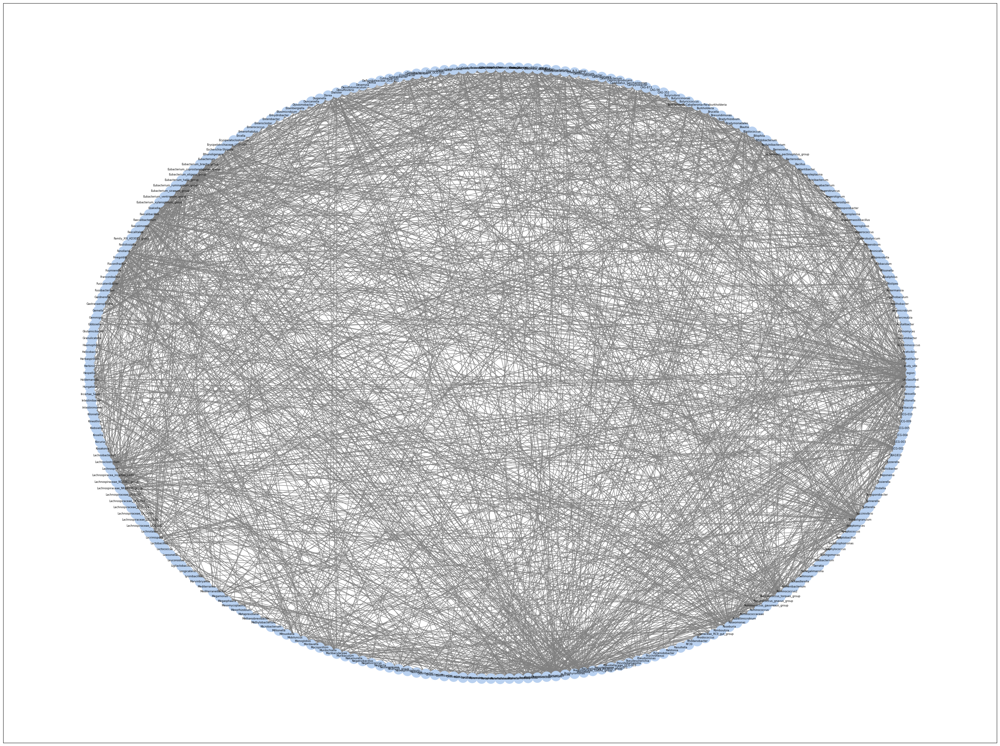

In [454]:
graph_networkx(sparcc_hc_adj, list(hc.columns), 'sparcc_HC')

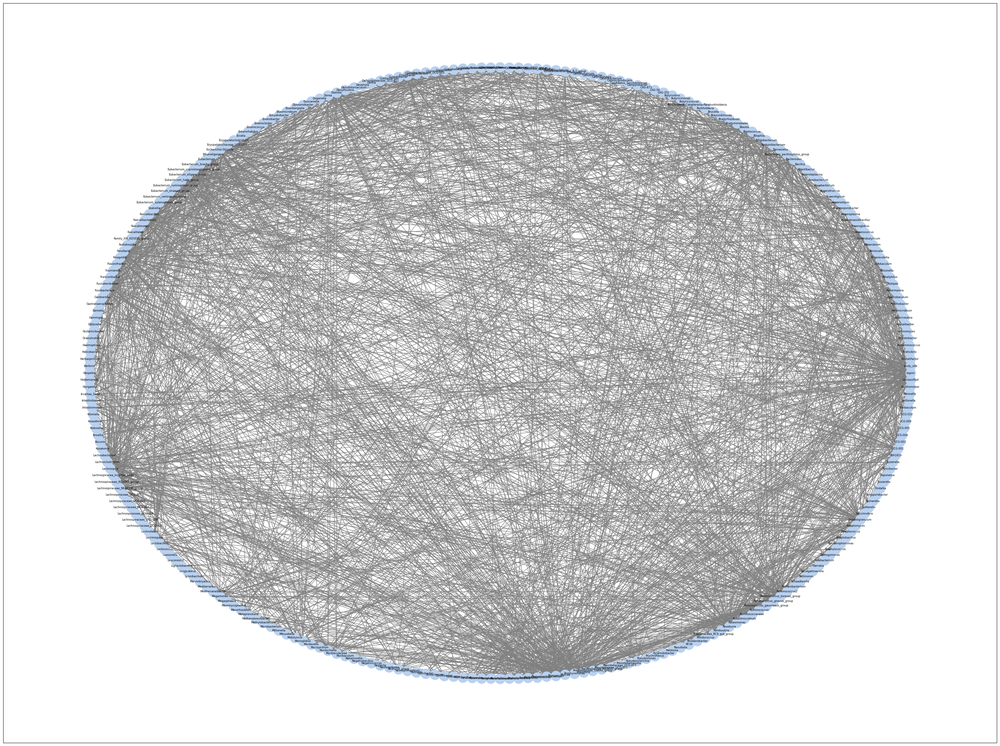

In [455]:
graph_networkx(sparcc_pcos_adj, list(pcos.columns), 'sparcc_PCOS')

In [ ]:
sparcc_hc_ouralg = run_ouralg(sparcc_hc_adj, hc, list(hc.columns), fisherz)
graph_networkx(sparcc_hc_ouralg, list(hc.columns), 'sparcc_hc_ouralg')

/opt/anaconda3/envs/capstone/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:2999: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/opt/anaconda3/envs/capstone/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:3000: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


## Graphical LASSO

In [73]:
# remember to use the smaller datasets, hc_short and pcos_short
glasso_hc_adj = np.full((hc_short.shape[1], hc_short.shape[1]), 0)
glasso_pcos_adj = np.full((pcos_short.shape[1], pcos_short.shape[1]), 0)

print('-----HC-----')
for i, genus_A in enumerate(hc_short.columns):
    print(genus_A)
    for j, genus_B in enumerate(hc_short.columns):
        if any((GLASSO_hc['genus_A'] == genus_A) & (GLASSO_hc['genus_B'] == genus_B)):
            glasso_hc_adj[i, j] = 1

print('-----PCOS-----')
for i, genus_A in enumerate(pcos_short.columns):
    print(genus_A)
    for j, genus_B in enumerate(pcos_short.columns):
        if any((GLASSO_pcos['genus_A'] == genus_A) & (GLASSO_pcos['genus_B'] == genus_B)):
            glasso_pcos_adj[i, j] = 1

-----HC-----
Acetatifactor
Agathobacter
Alistipes
Alloprevotella
Anaerococcus
Anaerostipes
Bacteroides
Bifidobacterium
Blautia
Burkholderia
Butyrivibrio
Campylobacter
Catenibacterium
Christensenellaceae_R-7_group
Clostridia_UCG-014
Collinsella
Coprococcus
Cronobacter
Dialister
Duncaniella
Erysipelotrichaceae_UCG-003
Escherichia-Shigella
Eubacterium_coprostanoligenes_group
Eubacterium_eligens_group
Eubacterium_hallii_group
Eubacterium_ruminantium_group
Faecalibacterium
Fenollaria
Finegoldia
Fusicatenibacter
Gemmiger
Herbinix
Holdemanella
Incertae_Sedis
Kineothrix
Lachnoclostridium
Lachnospira
Lachnospiraceae_NK4A136_group
Lactobacillus
Ligilactobacillus
Megamonas
Mitsuokella
Monoglobus
Muribaculaceae
Parabacteroides
Parasutterella
Peptoniphilus
Phascolarctobacterium
Phocaeicola
Porphyromonas
Prevotella
Pseudescherichia
Rikenellaceae_RC9_gut_group
Romboutsia
Roseburia
Ruminococcus
Ruminococcus_torques_group
Streptococcus
Subdoligranulum
Succinivibrio
Sutterella
UCG-002
UCG-005
Unclassifi

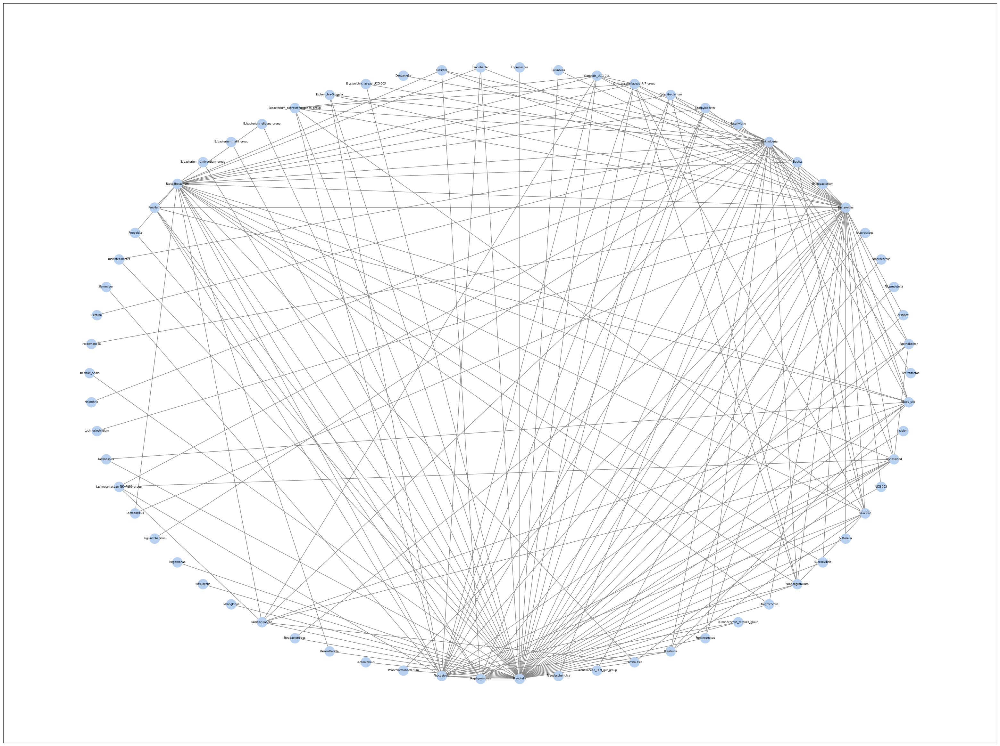

In [74]:
graph_networkx(glasso_hc_adj, list(hc_short.columns), 'glasso_HC')

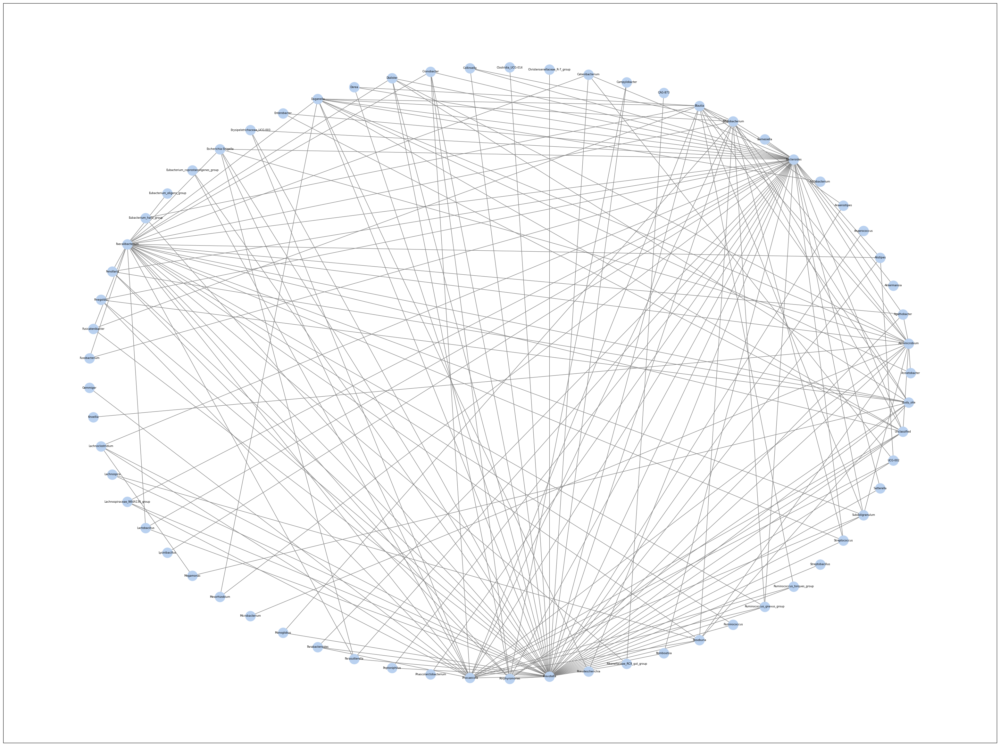

In [75]:
graph_networkx(glasso_pcos_adj, list(pcos_short.columns), 'glasso_PCOS')

In [113]:
glasso_hc_ouralg_short = np.full((15, 15), 0)
glasso_hc_ouralg_microbes = ['Agathobacter', 'Bacteroides', 'Burkholderia', 'Catenibacterium', 'Clostridia_UCG-014', 'Cronobacter', 
                            'Dialister', 'Escherichia-Shigella', 'Faecalibacterium', 'Phocaeicola', 'Prevotella', 
                            'Rikenellaceae_RC9_gut_group', 'Subdoligranulum', 'Succinivibrio', 'UCG-002']
glasso_pcos_ouralg_short = np.full((13, 13), 0)
glasso_pcos_ouralg_microbes = ['Aeromicrobium', 'Bacteroides', 'Bifidobacterium', 'Catenibacterium', 'Duganella', 'Enterobacter', 
                               'Escherichia-Shigella', 'Faecalibacterium', 'Fusobacterium', 'Lactobacillus', 'Lysinibacillus', 
                               'Prevotella', 'Rikenellaceae_RC9_gut_group']


In [114]:
glasso_hc_ouralg_sym = np.rot90(np.fliplr(glasso_hc_ouralg)) + glasso_hc_ouralg
glasso_pcos_ouralg_sym = np.rot90(np.fliplr(glasso_pcos_ouralg)) + glasso_pcos_ouralg

In [115]:
glasso_hc_ouralg_short = glasso_hc_ouralg_sym[~np.all(glasso_hc_ouralg_sym == 0, axis=0)]
glasso_hc_ouralg_short = np.delete(glasso_hc_ouralg_short, np.all(glasso_hc_ouralg_sym == 0, axis=1), axis=1)
glasso_hc_ouralg_short.shape

(15, 15)

In [116]:
glasso_pcos_ouralg_short = glasso_pcos_ouralg_sym[~np.all(glasso_pcos_ouralg_sym == 0, axis=0)]
glasso_pcos_ouralg_short = np.delete(glasso_pcos_ouralg_short, np.all(glasso_pcos_ouralg_sym == 0, axis=1), axis=1)
glasso_pcos_ouralg_short.shape

(13, 13)

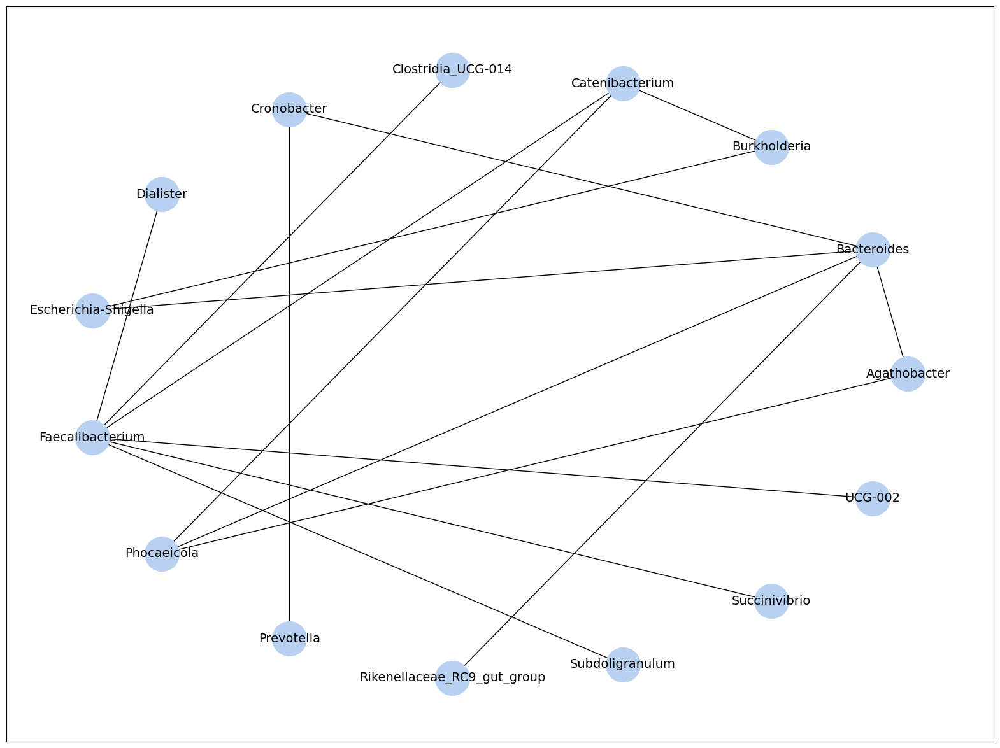

In [122]:
graph_networkx(glasso_hc_ouralg_short, glasso_hc_ouralg_microbes, 'glasso_hc_ouralg_short')

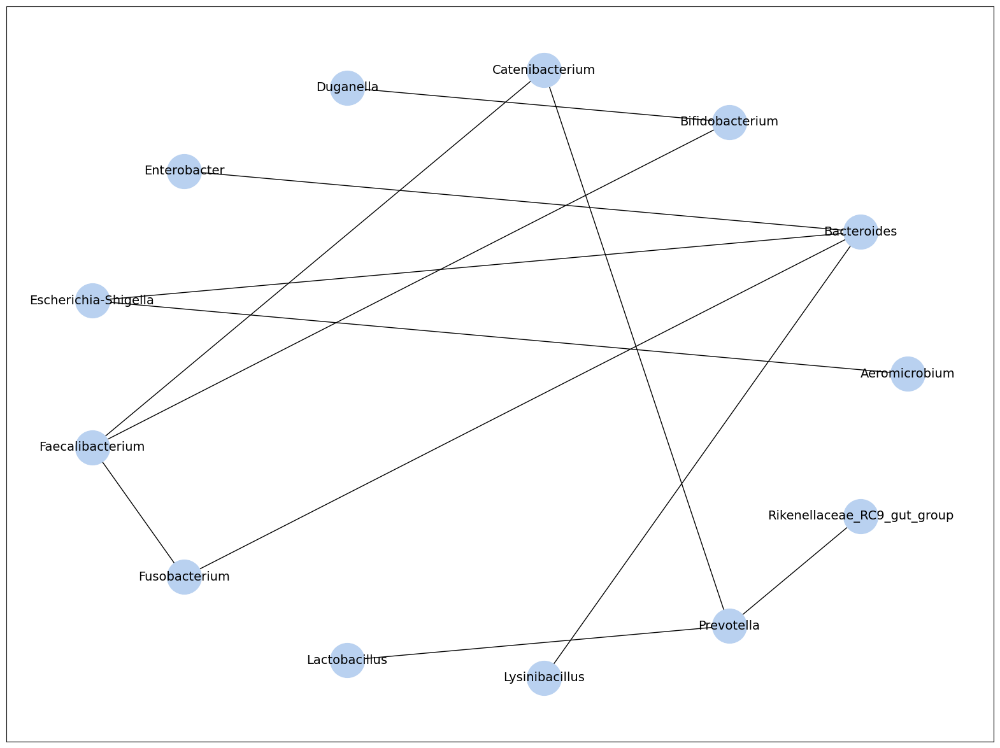

In [123]:
graph_networkx(glasso_pcos_ouralg_short, glasso_pcos_ouralg_microbes, 'glasso_pcos_ouralg_short')

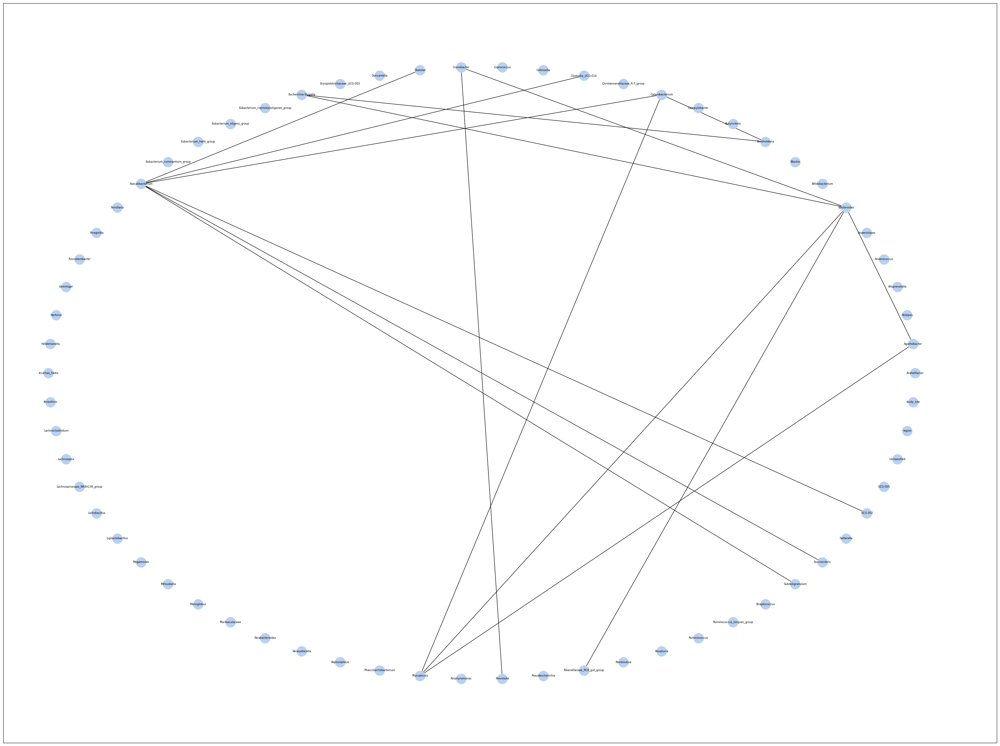

In [76]:
glasso_hc_ouralg = run_ouralg(glasso_hc_adj, hc_short, list(hc_short.columns), fisherz)
graph_networkx(glasso_hc_ouralg, list(hc_short.columns), 'glasso_hc_ouralg')

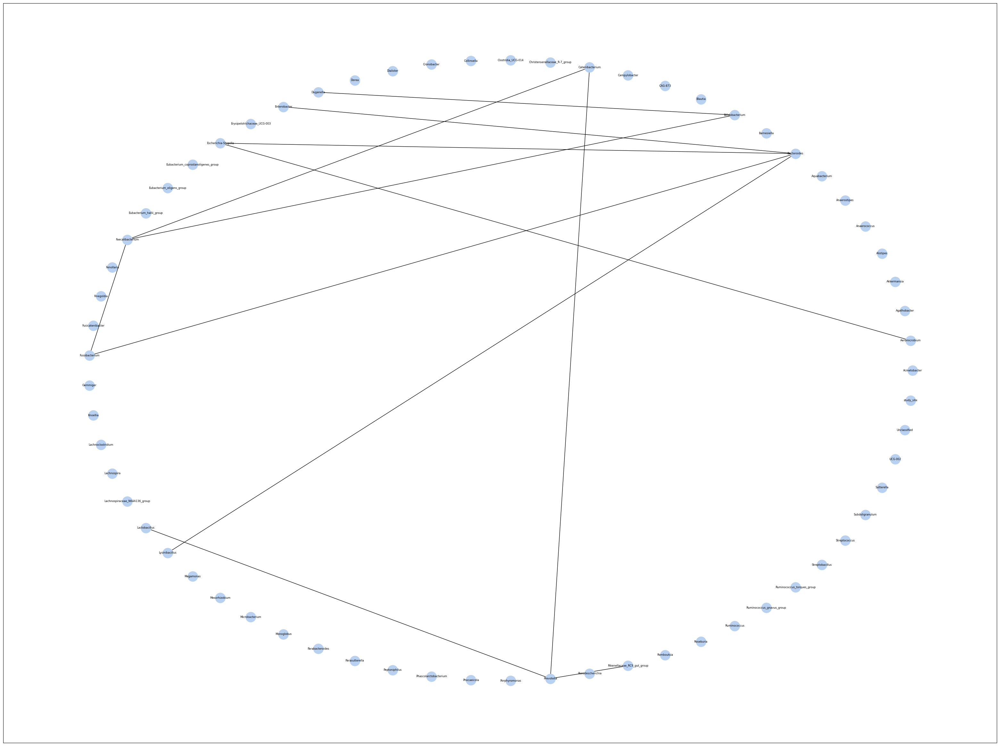

In [77]:
glasso_pcos_ouralg = run_ouralg(glasso_pcos_adj, pcos_short, list(pcos_short.columns), fisherz)
graph_networkx(glasso_pcos_ouralg, list(pcos_short.columns), 'glasso_pcos_ouralg')

In [121]:
def fisherz(genus_A, genus_B, genus_C, data):
    '''
    Run the Fisher Z (conditional) independence test between genus_A and genus_B conditioned on genus_c.

    :param: genus_A: index of the first genus to test independence
    :param: genus_B: index of the second genus to test independence
    :param: genus_C: index/list of index of the conditioning set
    :param: data: data containing the genus values
    '''
    fisherz_obj = CIT(data.values, "fisherz")
    pValue = fisherz_obj(genus_A, genus_B, genus_C)
    return pValue


def run_ouralg(adj_matrix, data, genus_lst, indep_test):
    '''
    Run our algorithm on the data and save the plot of the resulting causal graph. The methodology can be found in the associated paper. Returns the resulting adjacency matrix.

    :param: adj_matrix: adjacency matrix of the correlation graph from the paper
    :param: data: data for the corresponding cohort
    :param: genus_lst: list of genus corresponding to the adjacency matrix as node labels
    :param: indep_test: choice of independence test

    :return: the updated adjacency matrix
    '''
    adj_df = pd.DataFrame(adj_matrix, columns=genus_lst, index=genus_lst)

    
    def create_tuples(genus_lst, genus_A, genus_B):
        '''
        Creates tuples of 2 combinations for all items in genus_lst except genus_a and genus_b.
        
        :param: genus_lst: list of genus names
        :param: genus_A: index of the first genus to exclude
        :param: genus_B: index of the second genus to exclude
    
        :return: list of tuples, where each tuple contains two distinct genus names from genus_lst, excluding genus_a and genus_b.
        '''
        filtered_genus_lst = [x for x in range(len(genus_lst)) if (x != genus_A) and (x != genus_B)]
        combinations = list(itertools.combinations(filtered_genus_lst, 2))
        
        return combinations
        
    
    removed_edges = {}

    for i in range(len(genus_lst)):
        for j in range(len(genus_lst)):
            if adj_df.iloc[i, j] == 1.0:
                genus_A = i
                genus_B = j
                for k in range(len(genus_lst)):
                    if k != i and k != j:
                        genus_C = [k]
                        try: 
                            p_value = indep_test(genus_A, genus_B, genus_C, data)
                        except:
                            p_value = 1
    
                        if p_value < 0.05: # no multiple testing correction
                            adj_df.iloc[i, j] = 0
                            removed_edges[(i, j)] = [genus_C]
                            break
    
    for i in range(len(genus_lst)):
        for j in range(len(genus_lst)):
            if adj_df.iloc[i, j] == 1.0:
                genus_A = i
                genus_B = j
                combinations = create_tuples(genus_lst, genus_A, genus_B)
    
                for k in combinations:
                    genus_C = k
                    try :
                        p_value = indep_test(genus_A, genus_B, list(genus_C), data)
                    except:
                        p_value = 1
    
                    if p_value < 0.05:
                        adj_df.iloc[i, j] = 0
                        removed_edges[(i, j)] = [genus_C]
                        break
                    else:
                        adj_df.iloc[i, j] = 2
                        
    return adj_df.values

def graph_networkx(adj_matrix, genus_lst, fp):
    '''
    Create a NetworkX graph of the adjacency matrix and corresponding genus as node labels. Currently uses the circular layout for optimal viewing.

    :param: adj_matrix: adjacency matrix of size 45 x 45 of the genus to genus correlations
    :param: genus_lst: list of genus corresponding to the adjacency matrix as node labels
    '''
    if 1 in np.unique(adj_matrix):
        edge_val = 1
        edge_color = "gray"

    if 2 in np.unique(adj_matrix):
        edge_val = 2
        edge_color = "black"
        
    rows, cols = np.where(adj_matrix == edge_val)
    edges = zip(rows.tolist(), cols.tolist())
    edges = zip(rows.tolist(), cols.tolist())
    edge_list = list(edges)
    graph_labels = {i: genus_lst[i]for i in range(len(genus_lst))}
    
    plt.figure(figsize=(20,15))
    G = nx.Graph()
    G.add_nodes_from(range(len(genus_lst)))
    G.add_edges_from(edge_list)
    pos_spaced = nx.circular_layout(G)
    nx.draw_networkx(G, pos_spaced, node_size=1500, font_size=14, labels=graph_labels, with_labels=True, edge_color=edge_color, node_color="#b9d1f0")
    plt.savefig(f"{fp}.png")